In [1]:
#----------------------------------------------------------
#                          input 
#----------------------------------------------------------
"""
user에게 받은 사진을 AWS S3에 저장하고 그 url을 input으로 받는다.
"""

images = [
        {
            "id": 19,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/95c7716f-2610-4ae5-a37f-812f694b96d8"
        },
        {
            "id": 20,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/d525a2df-1e15-42c3-beef-1091dd80cb01"
        },
        {
            "id": 21,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/cf486a5a-2654-400e-9eea-e292f3ae7148"
        },
        {
            "id": 22,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/5d90e8ad-550c-4bcf-b42f-807449219f11"
        },
        {
            "id": 23,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/e28953c8-0bd0-44b8-9514-253bf87a02bc"
        },
        {
            "id": 24,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/fbf99922-1aa7-4e3f-b5ec-276a8c61da79"
        },
        {
            "id": 25,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/9c4d72bb-fb5e-4414-b983-f2f30b55725a"
        },
        {
            "id": 26,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/d15b367c-501b-4282-b5fe-5953f1cb5b99"
        },
        {
            "id": 27,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/969f761c-1431-4fd3-ba58-d452bd1184eb"
        },
        {
            "id": 28,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/90e01d7c-81bc-45dd-9736-eb0c0d626639"
        },
        {
            "id": 29,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/67607945-90d2-48ce-8b88-a6e40e34aac4"
        },
        {
            "id": 30,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/3b70edc0-9c1c-4acf-800d-4f8eb9a520ca"
        },
        {
            "id": 31,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/12864258-2f9c-45c6-8708-7a2748db42c3"
        },
        {
            "id": 32,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/043119aa-f025-4ee1-b28f-8b219cc409d9"
        },
        {
            "id": 33,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/dc792047-94b6-4910-bff1-5a860209cd07"
        },
        {
            "id": 34,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/21f1f4b2-dbbe-4041-a766-2bd03e468074"
        },
        {
            "id": 35,
            "url": "https://capstone-aftertrip-test.s3.ap-northeast-2.amazonaws.com/40f8098b-0b21-4fe6-afc0-156ebfb7c2cf"
        }
]

In [2]:
#----------------------------------------------------------
#                          drive mount 
#----------------------------------------------------------
from google.colab import drive
drive.mount('/content/drive/')

#%cd /content/drive/MyDrive/
#!git clone https://github.com/vinotharjun/FaceGrouping.git


#----------------------------------------------------------
#                          install 
#----------------------------------------------------------
base_folder = '/content/drive/MyDrive/Capstone_FaceRecognition'
%cd {base_folder}

!pip install mtcnn
!pip install -r requirements.txt #embedding & tsne 위한 설치

Mounted at /content/drive/
/content/drive/MyDrive/Capstone_FaceRecognition
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 33.0 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.8/38.8 MB 22.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.3/7.3 MB 31.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
ERROR: Could not find a version that satisfies the requirement opencv-python==4.3.0.36 (from versions: 3.4.0.14, 3.4.10.37, 3.4.11.39, 3.4.11.41, 3.4.11.43, 3.4.11.45, 3.4.13.47, 3.4.14.51, 3.4.14.53, 3.4.15.55, 3.4.16.57, 3.4.16.59, 3.4.17.61, 3.4.17.63, 3.4.18.65, 4.3.0.38, 4.4.0.40, 4.4.0.42, 4.4.0.44, 4.4.0

In [3]:
#----------------------------------------------------------
#                          import 
#----------------------------------------------------------
import os
import time
import cv2
import numpy as np
from PIL import Image
from tqdm import tqdm
from urllib import request

from io import BytesIO
from google.colab.patches import cv2_imshow
import urllib.request
import matplotlib.pyplot as plt

import torch
import torch.utils.data as data
import torchvision.datasets as datasets
import torch.nn.functional as F
import torchvision.transforms as transforms

from backbone import Backbone
from mtcnn.mtcnn import MTCNN
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import scale


#----------------------------------------------------------
#                      global variable
#----------------------------------------------------------
url_dict = {}
faces = []
groups = []

input_size = 112
group_name = 'group0'
crop_file_num = 0
crop_base_folder = "/content/drive/MyDrive/Capstone_FaceRecognition/crop"
crop_folder = f"/content/drive/MyDrive/Capstone_FaceRecognition/crop/{group_name}"
cos_distance_threshold = 0.45 
is_already_in_group = False


#----------------------------------------------------------
#                        functions 
#----------------------------------------------------------
def face_crop(img_idx, pixels, required_size=(112, 112)): 
    """
    MTCNN 모델을 이용해 Face Detection 하는 function

    Args:
      img_idx (int): images[] 에서의 idx
      pixels (list): 얼굴을 detect할 이미지를 pixel list로 바꾼 것
      required_size (tuple) : default(112, 112)

    Returns:
      None

    Details:
      input: 이미지 1개의 pixel
      action: MTCNN 적용해서 face detection (alignment는 안된다)
      output: crop 폴더에 detect한 이미지 crop해서 저장한다
    """

    # FaceDetection, 얼굴탐지
    # MTCCN 모델 이용
    detector = MTCNN()
    results = detector.detect_faces(pixels)

    # 얼굴이 없는 이미지
    if len(results)==0:
      images[img_idx]["face_idx"] = [0]

    # 얼굴이 1개이상인 이미지 
    crop_file_num = 1
    for i in range(len(results)):
        x1, y1, width, height = results[i]['box']
        x1, y1 = abs(x1), abs(y1)
        x2, y2 = x1 + width, y1 + height
        face = pixels[y1:y2, x1:x2]
        image = Image.fromarray(face)
        image = image.resize(required_size)

        # crop 폴더에 이미지 저장
        if not os.path.isdir(crop_base_folder):
          os.mkdir(crop_base_folder)

        if not os.path.isdir(crop_folder):
          os.mkdir(crop_folder)
        
        crop_path = crop_folder + '/' + str(img_idx) + "_" + str(crop_file_num) + ".jpg" 
        crop_file_num = crop_file_num + 1
        print("crop_path = ", crop_path)
        image.save(crop_path)

        # dictionary를 이용해 crop_path와 original_image_idx mapping 
        url_dict[crop_path] = img_idx


def alignment(): 
    """
    얼굴 각도 조절하는 함수 (미완성)
    robust하게 하려면 alignment 진행해야하지만
    이거까지 넣으면 속도가 너무 느려질 것 같아서 일부러 안넣음

    Args:
      

    Returns:
      

    Details:
  
    """


def get_embeddings(data_root, model_root, input_size=[112, 112], embedding_size=512):
    """
    data root에 들은 모든 이미지들을 Arcface 모델을 이용해 embedding하는 함수 

    Args:
      data_root (str) : crop된 이미지들이 들어있는 폴더의 path (이 폴더 안에 하위폴더가 한개이상 존재해야함 ex)data_root/cat, data_root/dog 폴더 구조 처럼)
      model_root (str) : arcface 모델의 .pth 파일의 path

    Returns:
      faces (list): [{
                      "crop_path" : crop_path
                      "face_idx" : 전체 얼굴 중에서 몇번째 얼굴인지 (이게 all_faces의 idx랑 동일함)
                      "face" : [얼굴 pixel RGB] 
                    }]

      embeddings (list):[[embedding1], [embedding2] ... [embeddingN]]
    """

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    # data & model 경로
    assert os.path.exists(data_root)
    assert os.path.exists(model_root)
    print(f"Data root: {data_root}")

    # define image preprocessing
    transform = transforms.Compose(
        [
            transforms.Resize(
                [int(128 * input_size[0] / 112), int(128 * input_size[0] / 112)],
            ),  # smaller side resized
            transforms.CenterCrop([input_size[0], input_size[1]]),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
        ],
    )

    # define data loader
    dataset = datasets.ImageFolder(data_root, transform)
    loader = data.DataLoader(
        dataset, batch_size=1, shuffle=False, pin_memory=True, num_workers=0,
    )

    # chekpoint에서 backbone weight 불러오기
    backbone = Backbone(input_size)
    backbone.load_state_dict(torch.load(model_root, map_location=torch.device("cpu")))
    backbone.to(device)
    backbone.eval()

    # crop 폴더에 들은 얼굴마다 embedding 하기
    embeddings = np.zeros([len(loader.dataset), embedding_size])
    with torch.no_grad():
        for idx, (image, _) in enumerate(
            tqdm(loader, desc="Create embeddings matrix", total=len(loader)),
        ):
            embeddings[idx, :] = F.normalize(backbone(image.to(device))).cpu()

    # faces 에 crop_path, face_idx, face 저장
    i = 0
    for crop_path, _ in dataset.samples:
      face = cv2.imread(crop_path)
      faces.append(
          {
            "crop_path":crop_path, 
            "face_idx" : i,
            "face":face
          }
      )
      i = i + 1

    return faces, embeddings

In [4]:
#----------------------------------------------------------
#                      Step1. face detect
#----------------------------------------------------------
for idx,image in enumerate(images):
  #  s3에서 생성된 url을 request&response로 받아서 img로 넘기기
  res = request.urlopen(image["url"]).read()
  img = Image.open(BytesIO(res))
  img = img.convert('RGB')
  pixels = np.asarray(img)  

  #  face detect 얼굴 탐지
  face_crop(idx, pixels)

2/2 [==============================] - 0s 21ms/step
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_1.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_2.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_3.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_4.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_5.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_6.jpg
1/1 [==============================] - 0s 186ms/step


2/2 [==============================] - 0s 23ms/step
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_1.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_2.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_3.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_4.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_5.jpg
1/1 [==============================] - 1s 699ms/step
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_1.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_2.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_3.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_4.jpg
1/1 [==============================] - 0s 372ms/step


2/2 [==============================] - 0s 17ms/step
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_1.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_2.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_3.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_4.jpg
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_5.jpg
1/1 [==============================] - 0s 146ms/step
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/4_1.jpg
1/1 [==============================] - 0s 152ms/step
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/5_1.jpg
1/1 [==============================] - 0s 151ms/step
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/6_1.jpg
1/1 [==============================] - 0s 224ms/step
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/7_1.jpg
1/1 [==

In [5]:
#----------------------------------------------------------
#                      Step2. embedding
#----------------------------------------------------------
#  embedding 하기
faces, embeddings = get_embeddings(
        data_root = crop_base_folder ,
        model_root = "checkpoint/backbone_ir50_ms1m_epoch120.pth",
        input_size = [input_size, input_size],
      )
print("faces 길이 = ", len(faces))
print("embeddings 길이 = ", len(embeddings)) 

#  faces에 embeddings 넣기
for i, embedding in enumerate(embeddings):
  faces[i]["embedding"] = embedding


#----------------------------------------------------------
#                      Step3. cos_similarity 계산
#----------------------------------------------------------
#  cosine_similarity[i][j]로 접근 가능
cosine_similaritys = np.dot(embeddings, embeddings.T)
cosine_similaritys = cosine_similaritys.clip(min=0, max=1)

Data root: /content/drive/MyDrive/Capstone_FaceRecognition/crop


Create embeddings matrix: 100%|██████████| 41/41 [00:11<00:00,  3.53it/s]

faces 길이 =  41
embeddings 길이 =  41


In [6]:
#----------------------------------------------------------
#                      Step4. grouping
#----------------------------------------------------------
# face1 : 비교 기준이 되는 이미지
# face2 : 지금 그룹을 정해주고 싶은은 이미지
for face2_idx, face2 in enumerate(faces) : # 해당 얼굴에 대해
    is_already_in_group = False

    # Case1 : 기존 그룹 탐색
    for group_idx, group in enumerate(groups): # 각 그룹마다
      for i, face1_idx in enumerate(group["face2_idx_list"]) : #그 그룹에 들어있는 얼굴마다
        cosine_similarity = cosine_similaritys[face1_idx][face2_idx]

        if( not is_already_in_group and cosine_similarity > cos_distance_threshold ) :
          crop_path = face2["crop_path"]
          original_images_idx = url_dict[crop_path]

          # images에 group idx 넣어주기
          if "group_idx" in images[original_images_idx] :
            images[original_images_idx]["group_idx"].append(group_idx)
          else :
            images[original_images_idx]["group_idx"] = [group_idx]

          # groups 갱신
          group["original_images_idx_list"].append(original_images_idx) #dictionary에서 원래 url idx 찾아넣기
          group["crop_path_list"].append(crop_path)
          group["face_list"].append(face2["face"])
          group["face2_idx_list"].append(face2_idx)
          group["face1_idx_list"].append(face1_idx)
          group["cosine_similarity_list"].append(cosine_similarity)

          is_already_in_group = True
          

    # Case2 : 못 넣었으면 새로운 그룹에 추가
    if not is_already_in_group :
      crop_path = face2["crop_path"]
      original_images_idx = url_dict[crop_path]

      # images에 group idx 넣어주기
      if "group_idx" in images[original_images_idx] :
        images[original_images_idx]["group_idx"].append(len(groups))
      else :
        images[original_images_idx]["group_idx"] = [len(groups)]

      # groups 갱신
      groups.append ({
          "original_images_idx_list" :[original_images_idx],
          "crop_path_list" : [crop_path],
          "face_list" : [face2["face"]],
          "face2_idx_list" : [face2_idx], 
          "face1_idx_list" : [[]],
          "cosine_similarity_list" : [-1]
      })

print(len(groups))

28


====================== group 0 =======================
face idx =  0
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_1.jpg


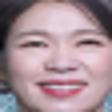

====================== group 1 =======================
face idx =  1
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_2.jpg


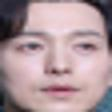

====================== group 2 =======================
face idx =  2
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_3.jpg


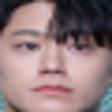

====================== group 3 =======================
face idx =  3
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_4.jpg


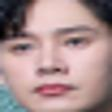

====================== group 4 =======================
face idx =  4
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_5.jpg


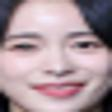

face idx =  9
cosine =  0.48107619537737556
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/10_4.jpg


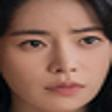

face idx =  20
cosine =  0.7011213491150388
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_2.jpg


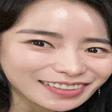

face idx =  32
cosine =  0.475752016499303
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_5.jpg


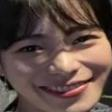

face idx =  33
cosine =  0.8661469778789499
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/4_1.jpg


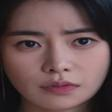

face idx =  34
cosine =  0.4974698240494337
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/5_1.jpg


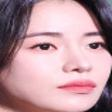

====================== group 5 =======================
face idx =  5
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_6.jpg


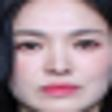

face idx =  16
cosine =  0.46106462414518
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/14_1.jpg


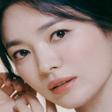

face idx =  35
cosine =  0.5208648163307087
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/6_1.jpg


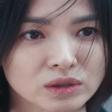

====================== group 6 =======================
face idx =  6
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/10_1.jpg


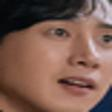

====================== group 7 =======================
face idx =  7
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/10_2.jpg


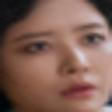

====================== group 8 =======================
face idx =  8
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/10_3.jpg


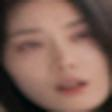

face idx =  11
cosine =  0.4893111791717736
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/11_2.jpg


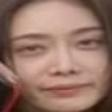

face idx =  21
cosine =  0.6455167143403274
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_3.jpg


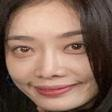

face idx =  30
cosine =  0.45605058163177625
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_3.jpg


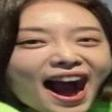

====================== group 9 =======================
face idx =  10
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/11_1.jpg


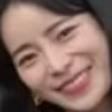

====================== group 10 =======================
face idx =  12
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/12_1.jpg


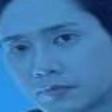

face idx =  26
cosine =  0.5251857558227802
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_3.jpg


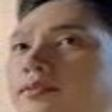

face idx =  29
cosine =  0.5473345977431249
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_2.jpg


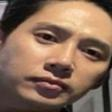

====================== group 11 =======================
face idx =  13
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/12_2.jpg


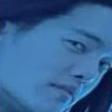

====================== group 12 =======================
face idx =  14
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/12_3.jpg


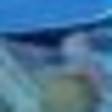

====================== group 13 =======================
face idx =  15
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/13_1.jpg


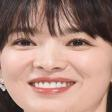

face idx =  24
cosine =  0.5153070391141115
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_1.jpg


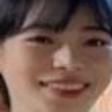

====================== group 14 =======================
face idx =  17
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/15_1.jpg


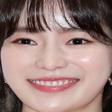

====================== group 15 =======================
face idx =  18
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/16_1.jpg


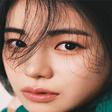

====================== group 16 =======================
face idx =  19
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_1.jpg


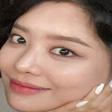

====================== group 17 =======================
face idx =  22
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_4.jpg


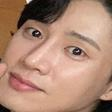

====================== group 18 =======================
face idx =  23
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_5.jpg


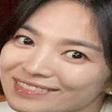

====================== group 19 =======================
face idx =  25
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_2.jpg


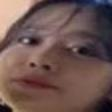

====================== group 20 =======================
face idx =  27
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_4.jpg


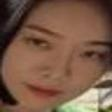

====================== group 21 =======================
face idx =  28
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_1.jpg


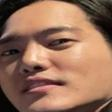

====================== group 22 =======================
face idx =  31
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_4.jpg


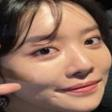

====================== group 23 =======================
face idx =  36
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/7_1.jpg


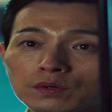

====================== group 24 =======================
face idx =  37
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/8_1.jpg


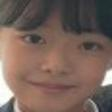

====================== group 25 =======================
face idx =  38
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/8_2.jpg


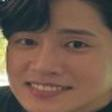

====================== group 26 =======================
face idx =  39
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/9_1.jpg


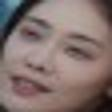

====================== group 27 =======================
face idx =  40
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/9_2.jpg


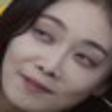

In [7]:
# grouping 잘됐나 테스트 1 (crop 이미지만 보기)
from google.colab.patches import cv2_imshow

for i in range(len(groups)):
  print("======================================================")
  print("====================== group", i, "=======================")
  for j in range(len(groups[i]["face_list"])):
    print("face idx = ", groups[i]["face2_idx_list"][j]) #face idx
    print("cosine = ", groups[i]["cosine_similarity_list"][j]) #cosine distance
    #cv2_imshow(groups[i]["face_list"][j]) #face

    crop_path = groups[i]["crop_path_list"][j]
    print("crop_path = ", crop_path)
    cv2_imshow(cv2.imread(crop_path)) 

====================== group 0 =======================
face idx =  0
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_1.jpg


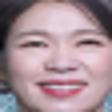

original_images_idx_list =  0


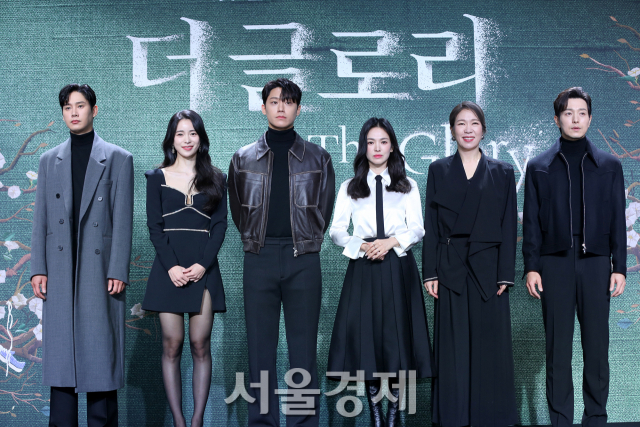

====================== group 1 =======================
face idx =  1
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_2.jpg


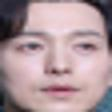

original_images_idx_list =  0


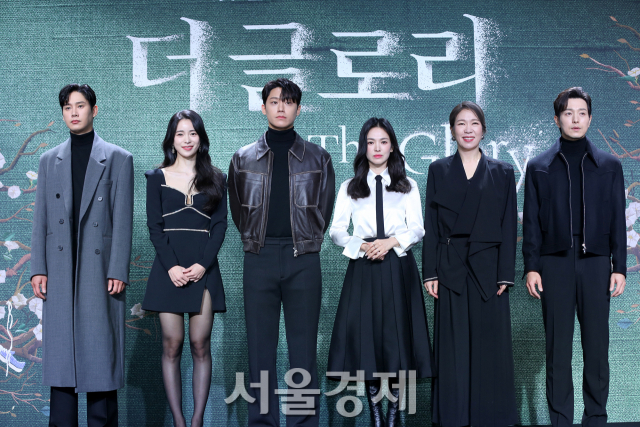

====================== group 2 =======================
face idx =  2
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_3.jpg


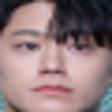

original_images_idx_list =  0


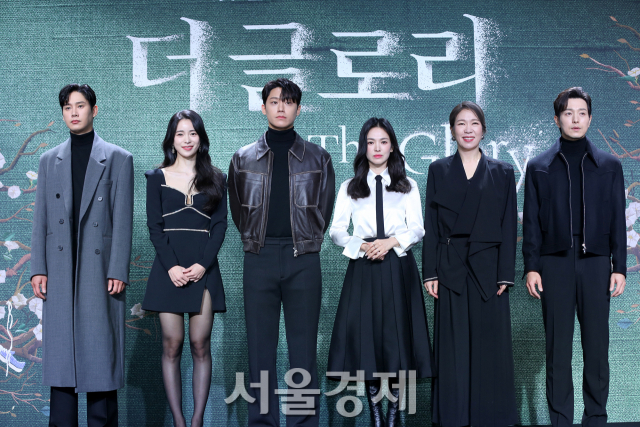

====================== group 3 =======================
face idx =  3
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_4.jpg


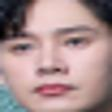

original_images_idx_list =  0


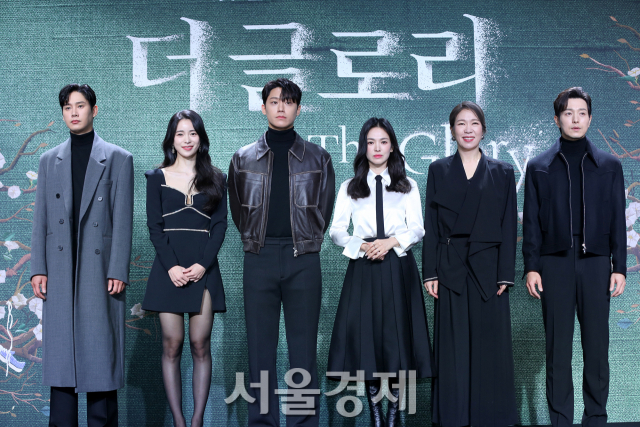

====================== group 4 =======================
face idx =  4
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_5.jpg


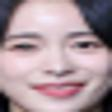

original_images_idx_list =  0


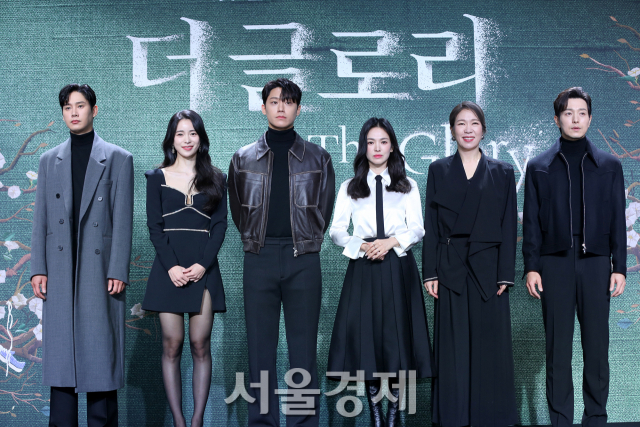

face idx =  9
cosine =  0.48107619537737556
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/10_4.jpg


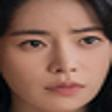

original_images_idx_list =  10


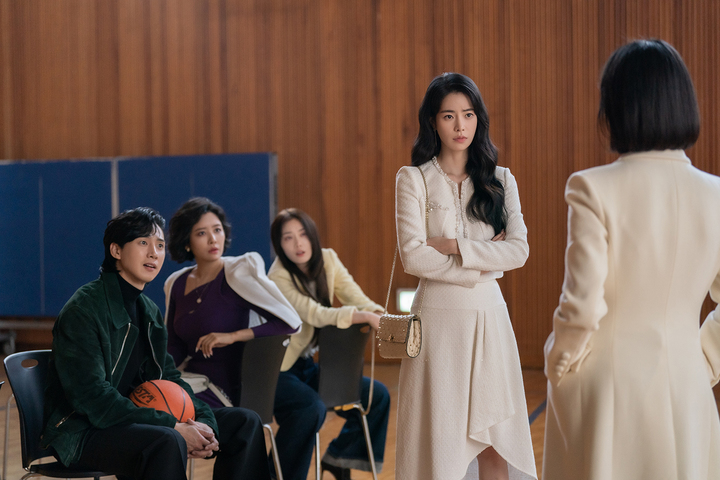

face idx =  20
cosine =  0.7011213491150388
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_2.jpg


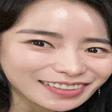

original_images_idx_list =  1


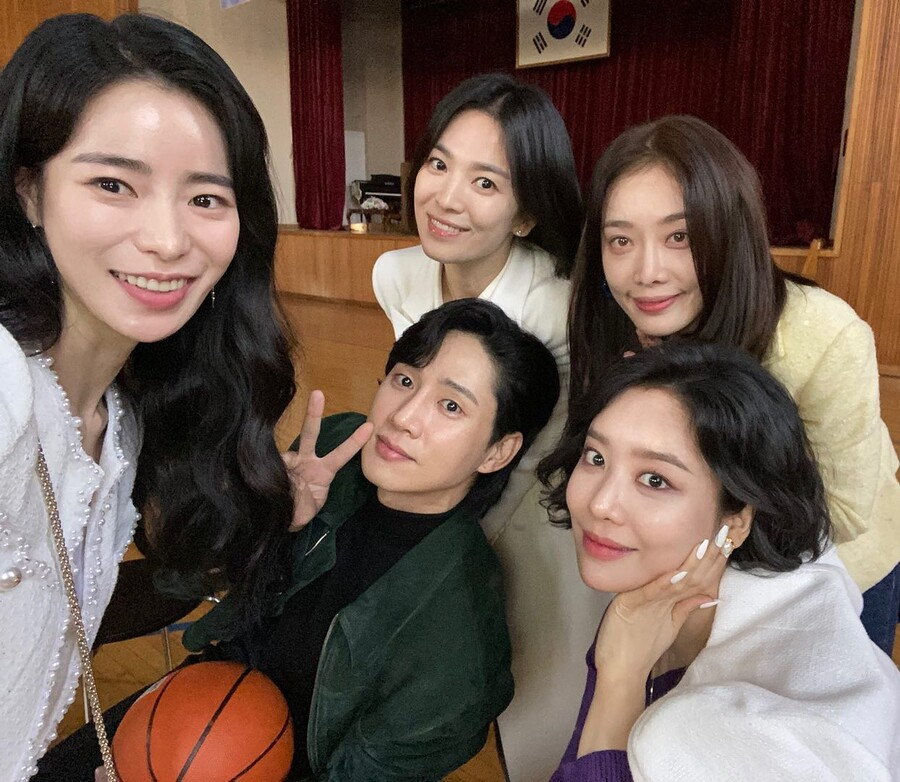

face idx =  32
cosine =  0.475752016499303
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_5.jpg


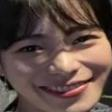

original_images_idx_list =  3


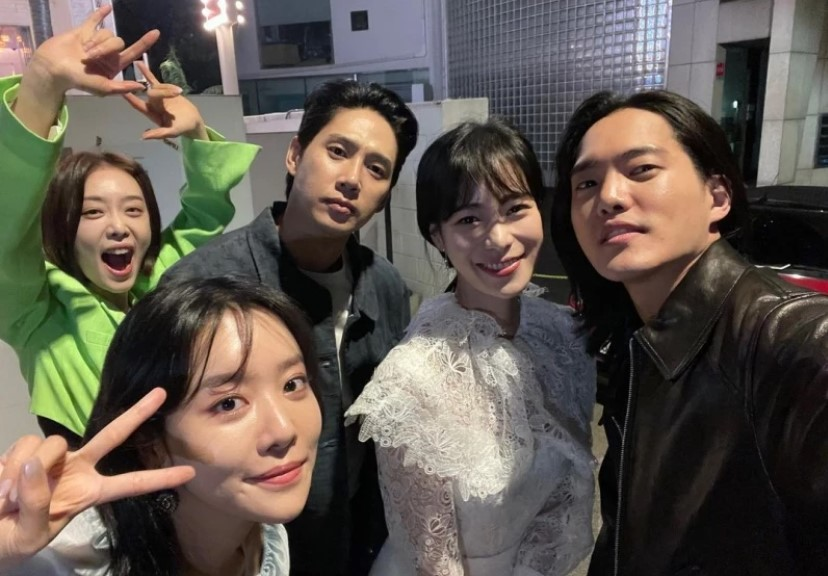

face idx =  33
cosine =  0.8661469778789499
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/4_1.jpg


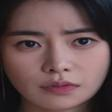

original_images_idx_list =  4


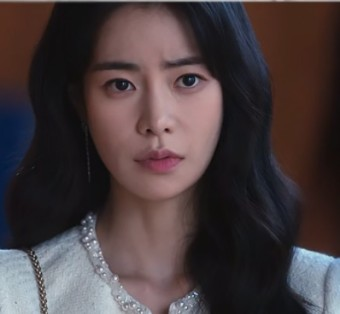

face idx =  34
cosine =  0.4974698240494337
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/5_1.jpg


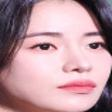

original_images_idx_list =  5


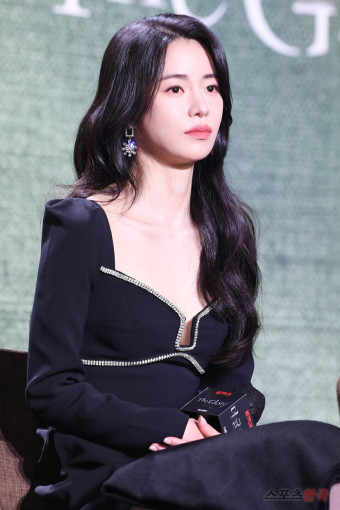

====================== group 5 =======================
face idx =  5
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/0_6.jpg


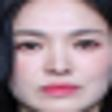

original_images_idx_list =  0


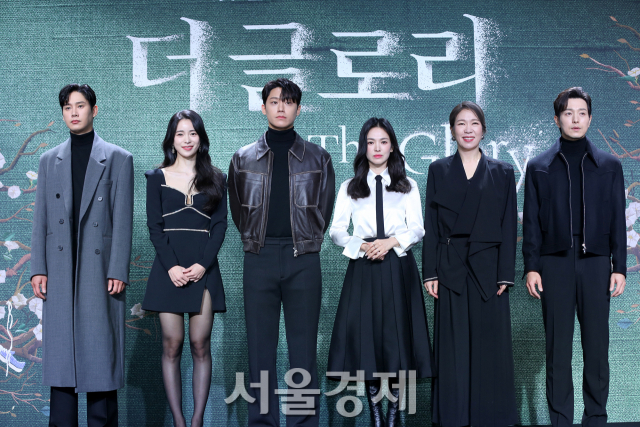

face idx =  16
cosine =  0.46106462414518
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/14_1.jpg


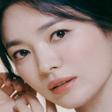

original_images_idx_list =  14


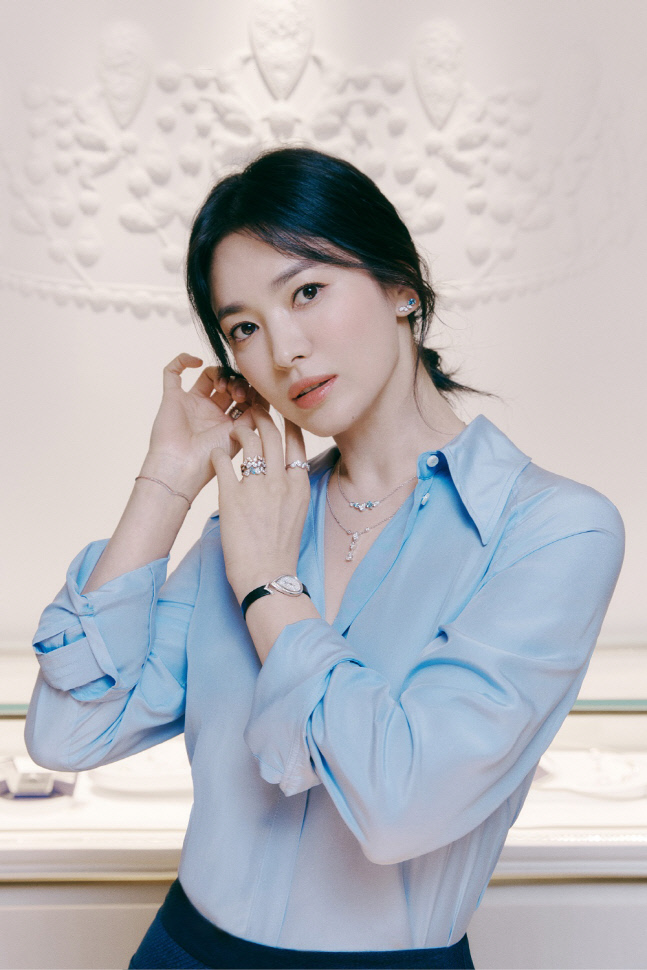

face idx =  35
cosine =  0.5208648163307087
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/6_1.jpg


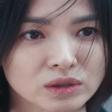

original_images_idx_list =  6


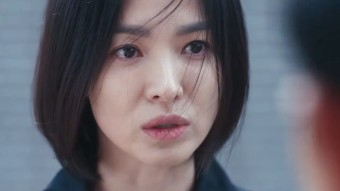

====================== group 6 =======================
face idx =  6
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/10_1.jpg


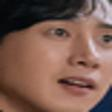

original_images_idx_list =  10


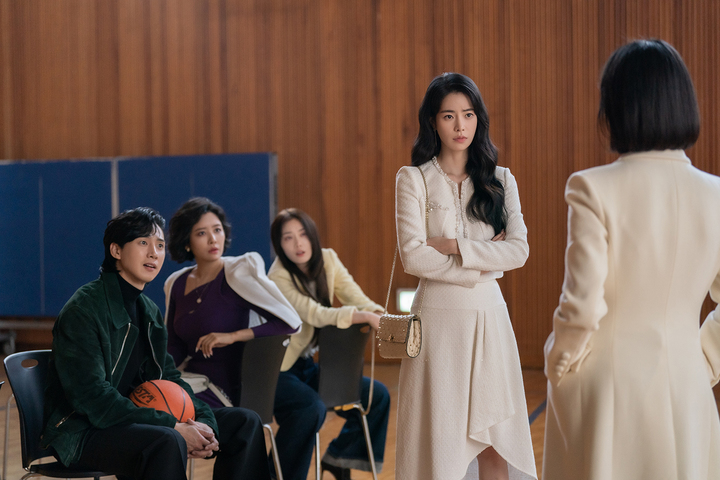

====================== group 7 =======================
face idx =  7
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/10_2.jpg


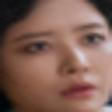

original_images_idx_list =  10


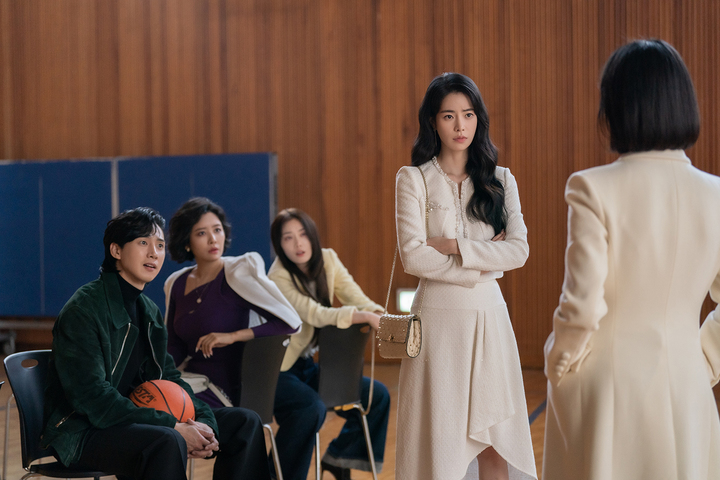

====================== group 8 =======================
face idx =  8
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/10_3.jpg


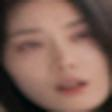

original_images_idx_list =  10


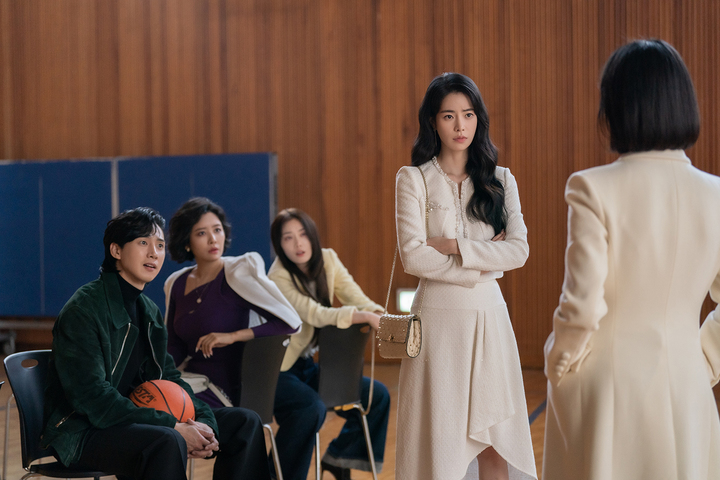

face idx =  11
cosine =  0.4893111791717736
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/11_2.jpg


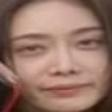

original_images_idx_list =  11


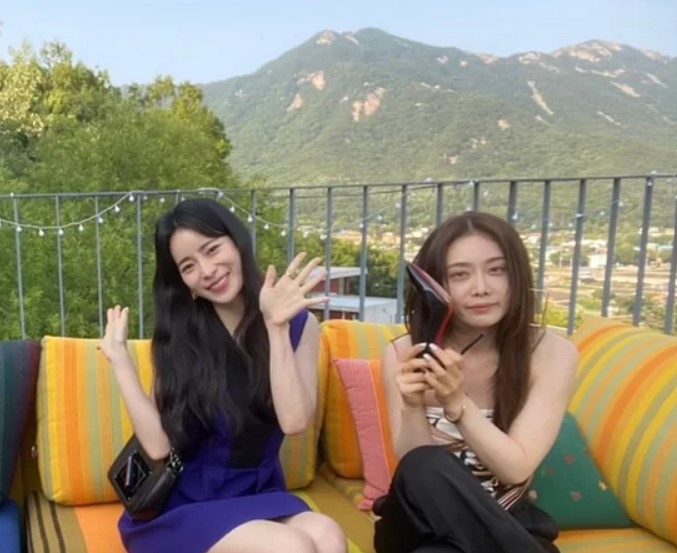

face idx =  21
cosine =  0.6455167143403274
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_3.jpg


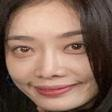

original_images_idx_list =  1


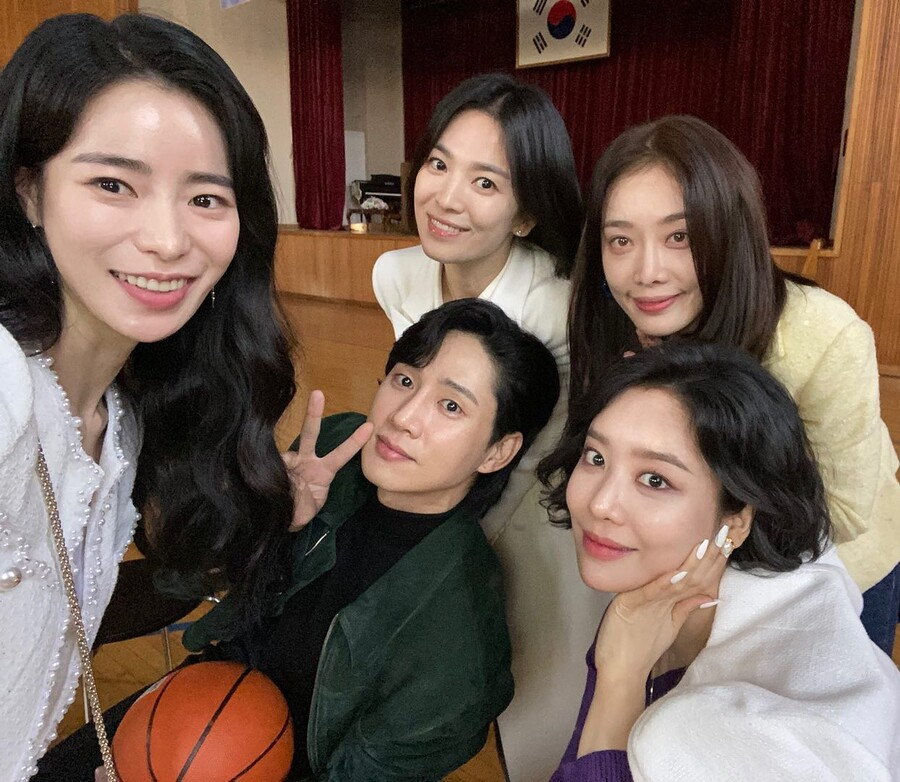

face idx =  30
cosine =  0.45605058163177625
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_3.jpg


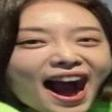

original_images_idx_list =  3


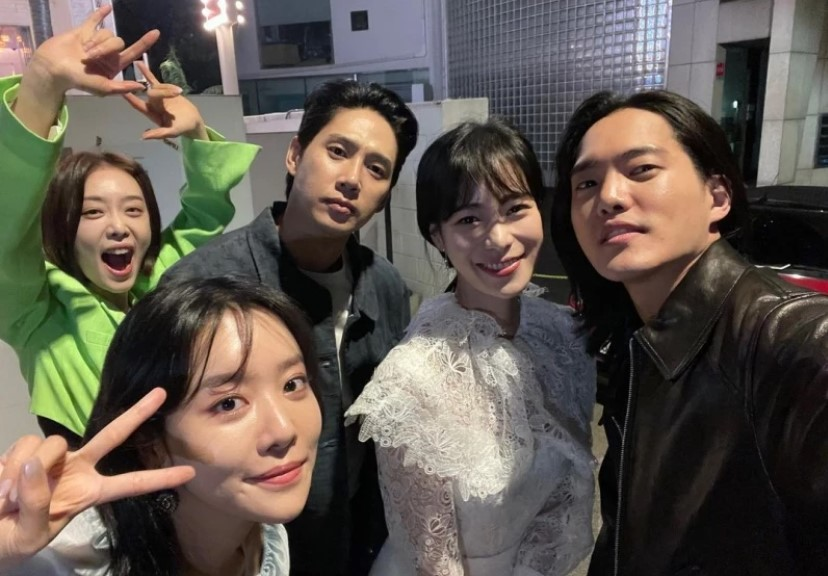

====================== group 9 =======================
face idx =  10
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/11_1.jpg


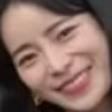

original_images_idx_list =  11


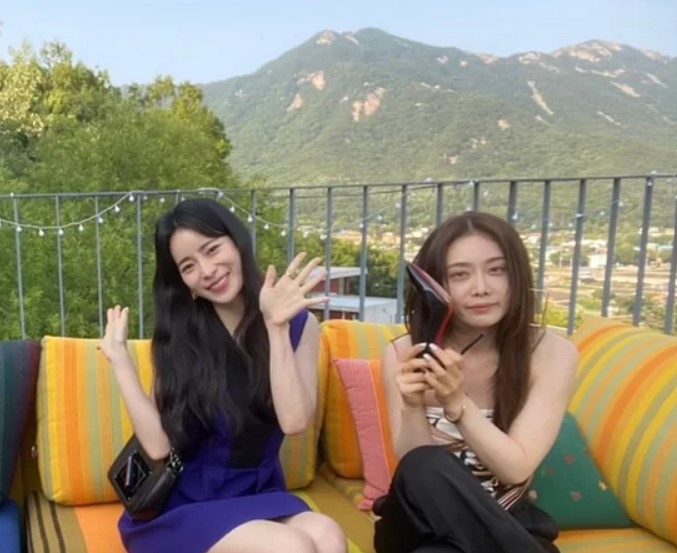

====================== group 10 =======================
face idx =  12
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/12_1.jpg


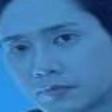

original_images_idx_list =  12


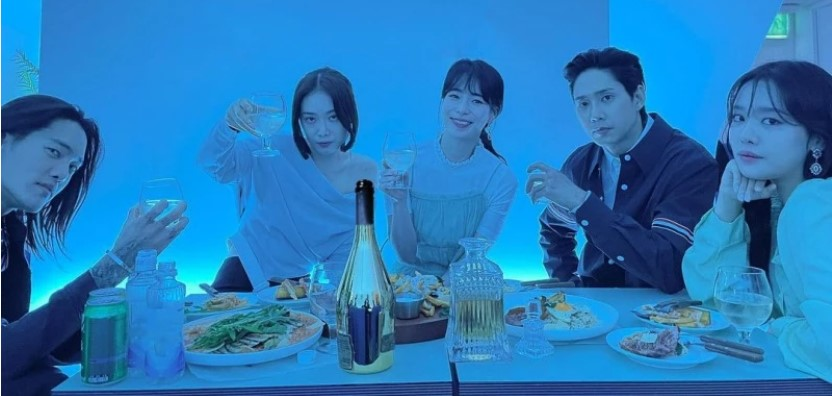

face idx =  26
cosine =  0.5251857558227802
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_3.jpg


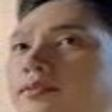

original_images_idx_list =  2


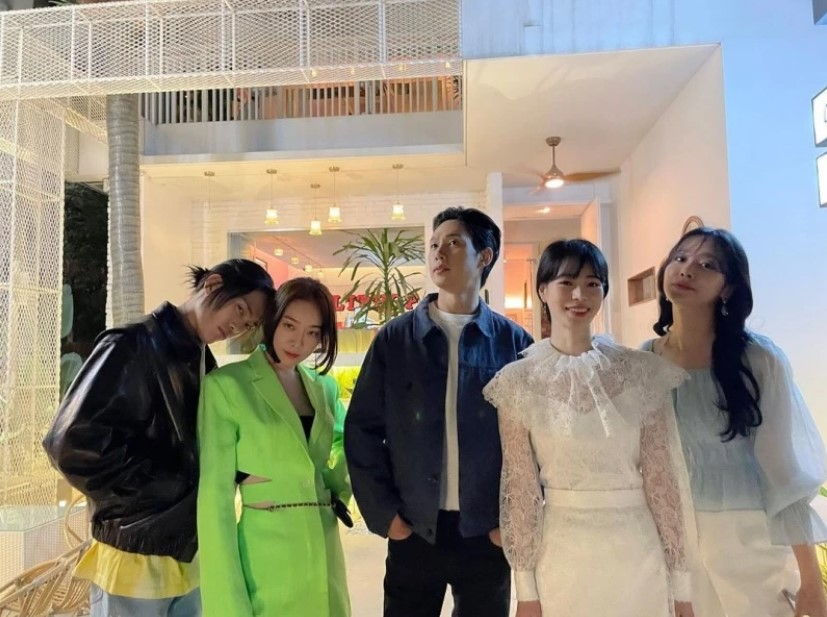

face idx =  29
cosine =  0.5473345977431249
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_2.jpg


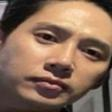

original_images_idx_list =  3


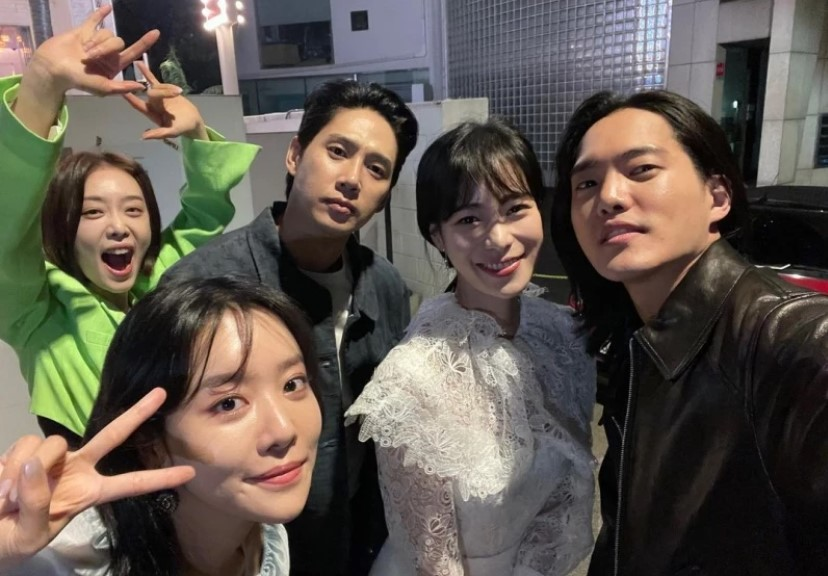

====================== group 11 =======================
face idx =  13
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/12_2.jpg


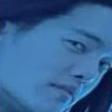

original_images_idx_list =  12


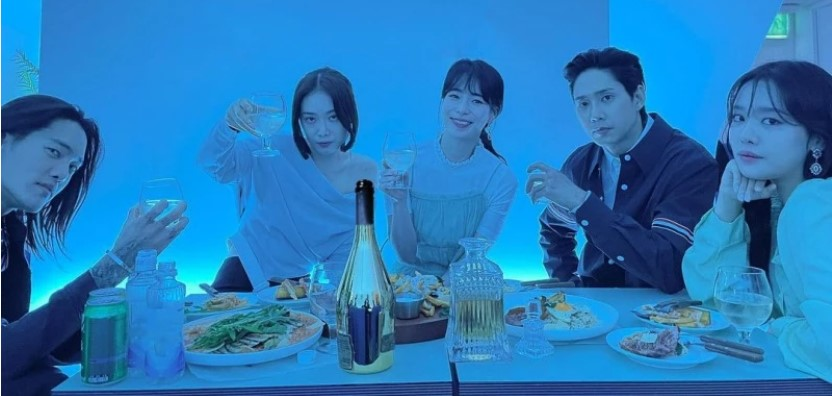

====================== group 12 =======================
face idx =  14
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/12_3.jpg


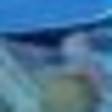

original_images_idx_list =  12


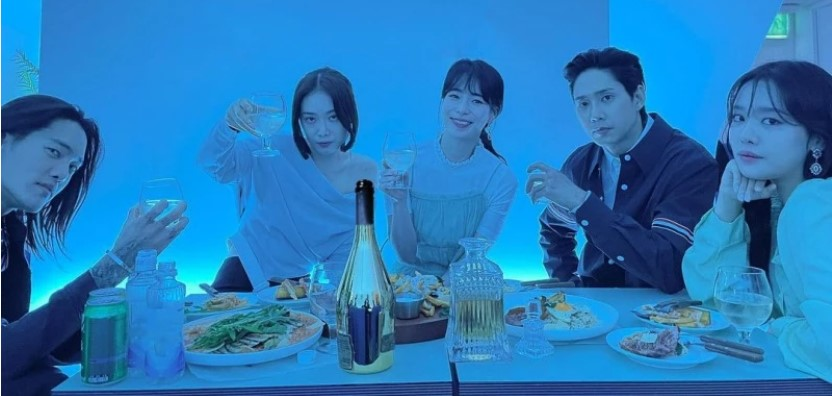

====================== group 13 =======================
face idx =  15
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/13_1.jpg


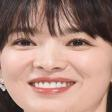

original_images_idx_list =  13


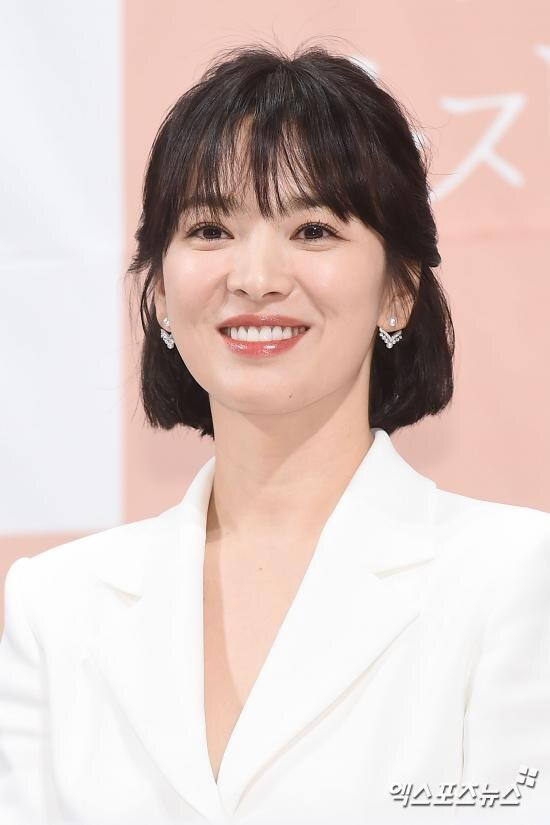

face idx =  24
cosine =  0.5153070391141115
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_1.jpg


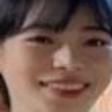

original_images_idx_list =  2


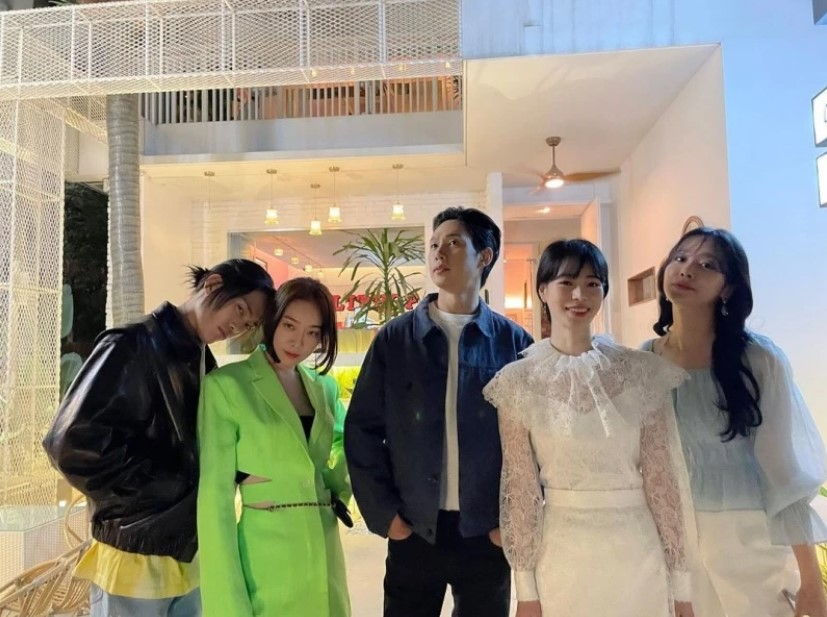

====================== group 14 =======================
face idx =  17
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/15_1.jpg


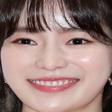

original_images_idx_list =  15


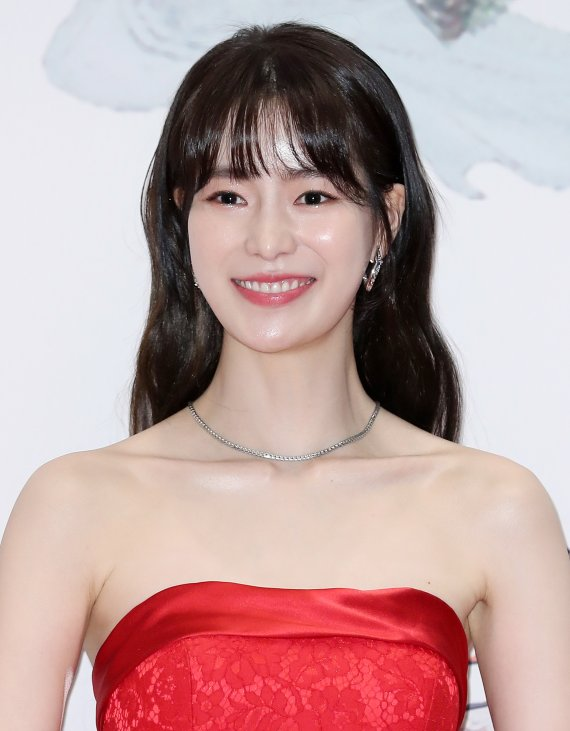

====================== group 15 =======================
face idx =  18
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/16_1.jpg


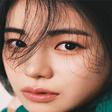

original_images_idx_list =  16


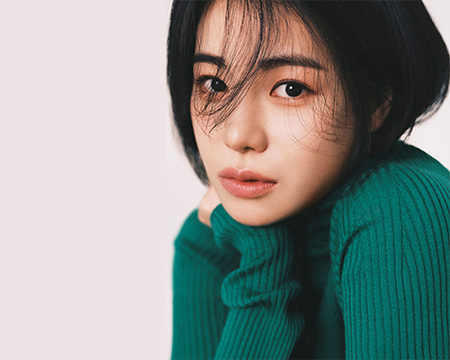

====================== group 16 =======================
face idx =  19
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_1.jpg


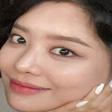

original_images_idx_list =  1


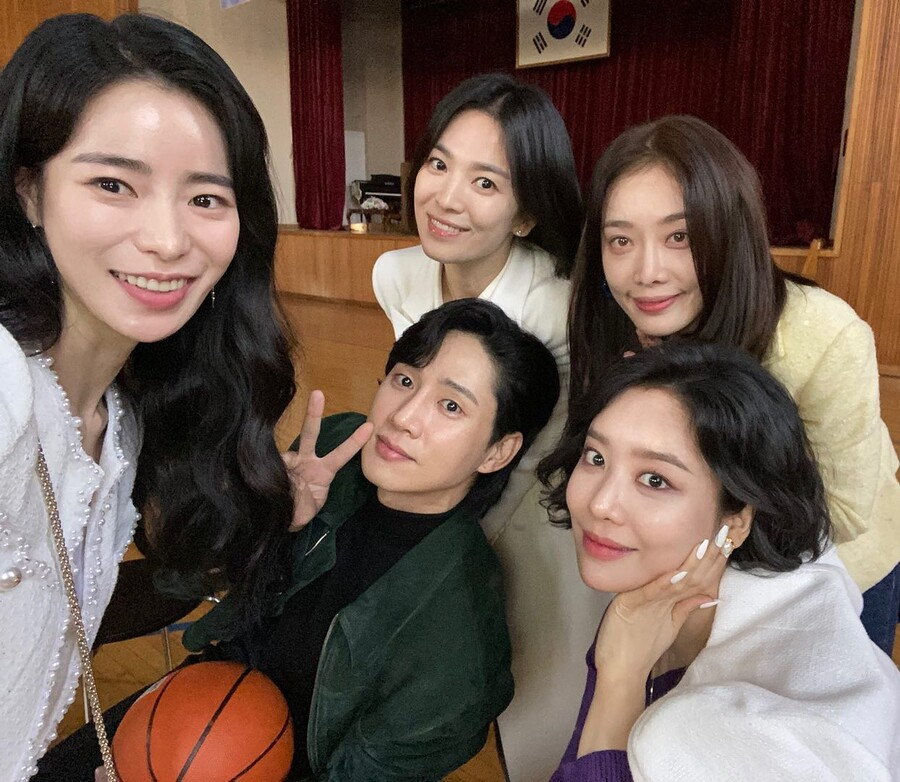

====================== group 17 =======================
face idx =  22
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_4.jpg


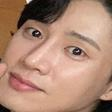

original_images_idx_list =  1


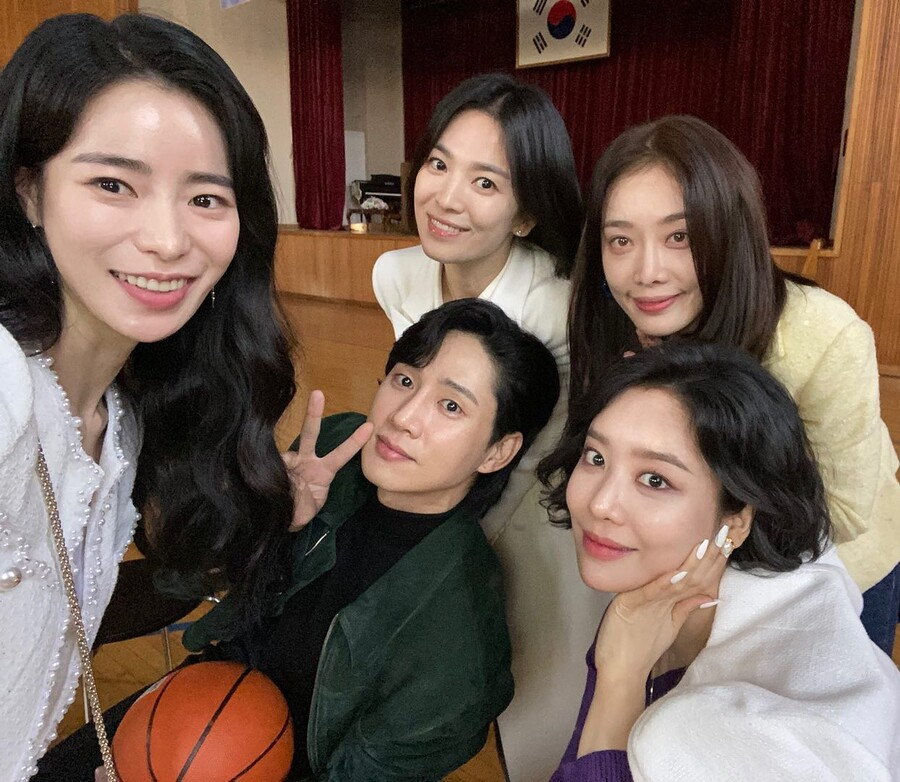

====================== group 18 =======================
face idx =  23
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/1_5.jpg


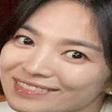

original_images_idx_list =  1


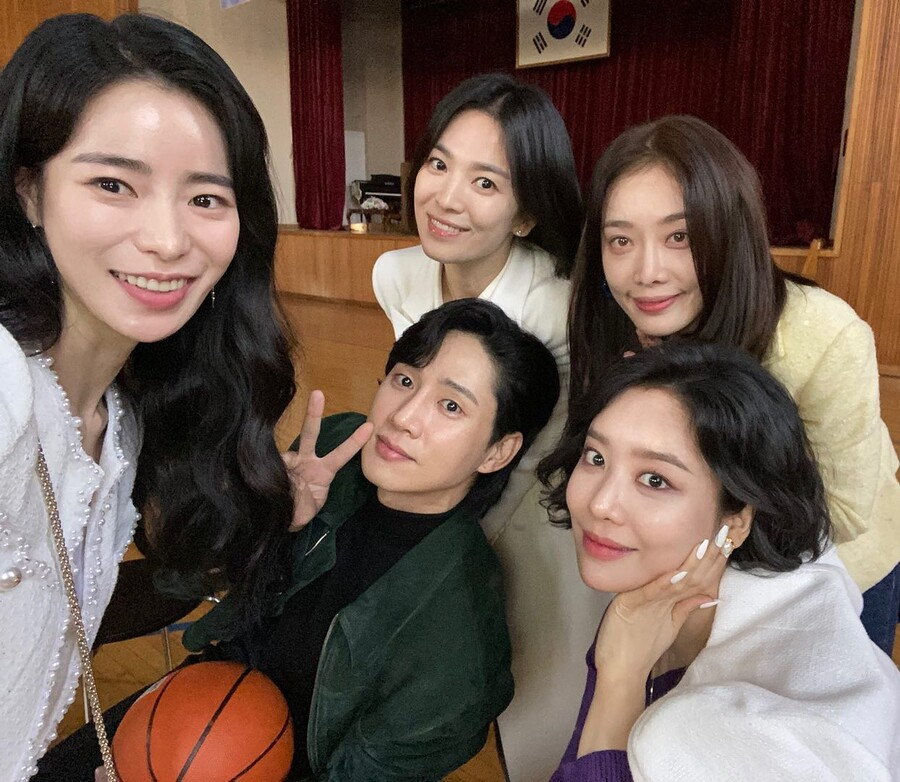

====================== group 19 =======================
face idx =  25
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_2.jpg


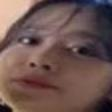

original_images_idx_list =  2


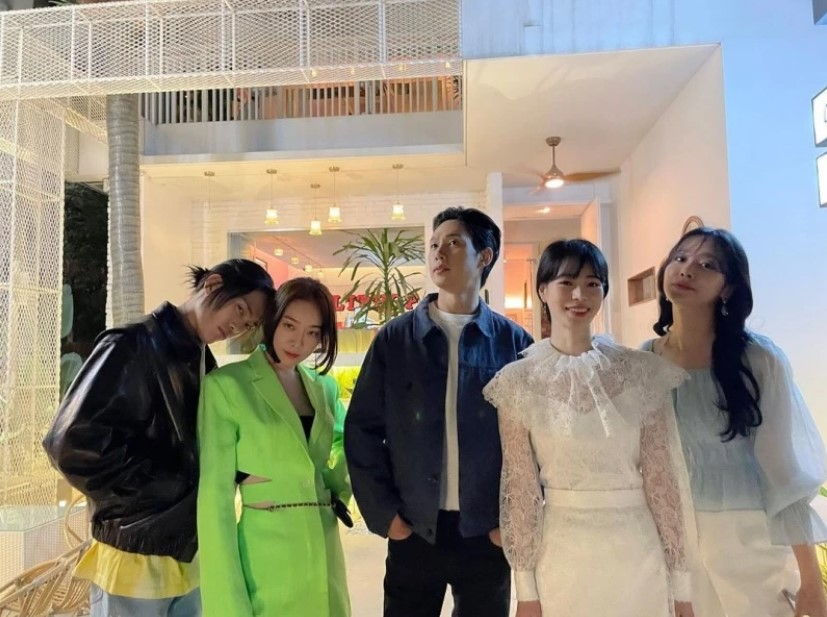

====================== group 20 =======================
face idx =  27
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/2_4.jpg


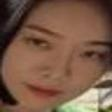

original_images_idx_list =  2


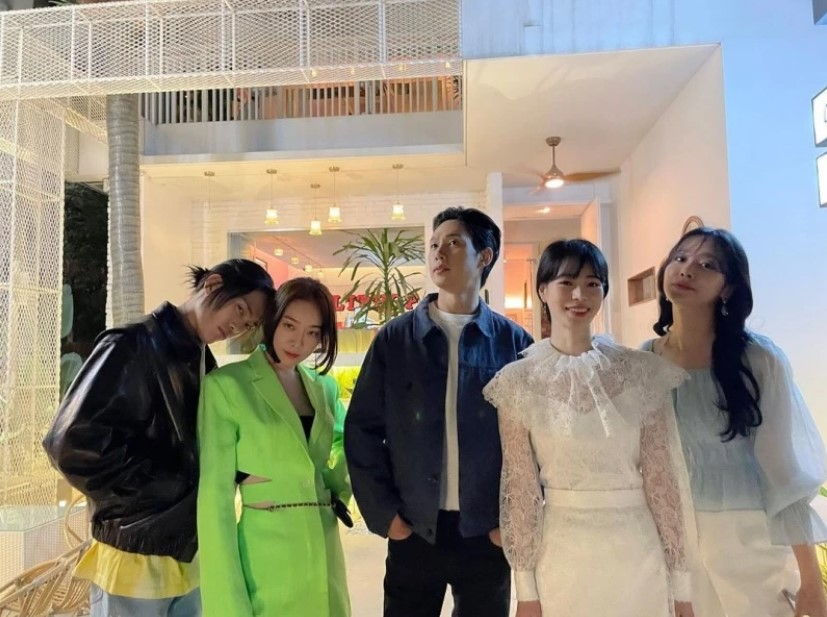

====================== group 21 =======================
face idx =  28
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_1.jpg


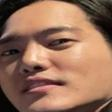

original_images_idx_list =  3


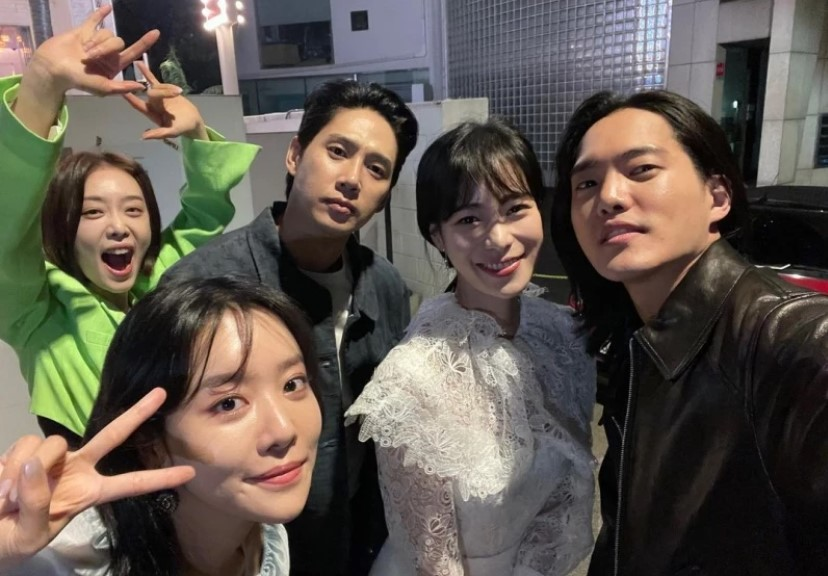

====================== group 22 =======================
face idx =  31
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/3_4.jpg


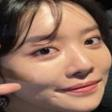

original_images_idx_list =  3


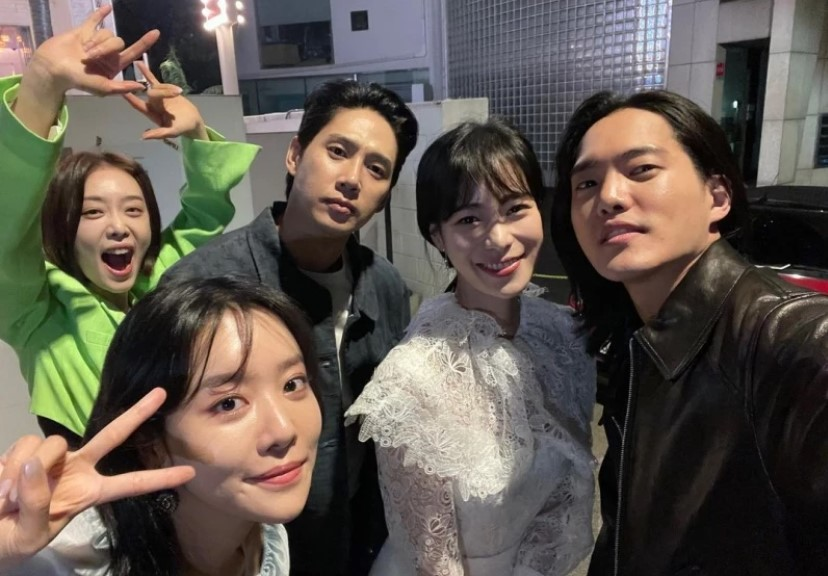

====================== group 23 =======================
face idx =  36
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/7_1.jpg


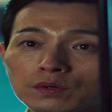

original_images_idx_list =  7


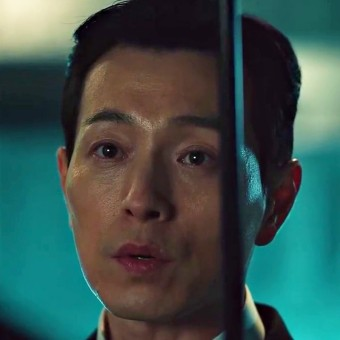

====================== group 24 =======================
face idx =  37
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/8_1.jpg


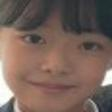

original_images_idx_list =  8


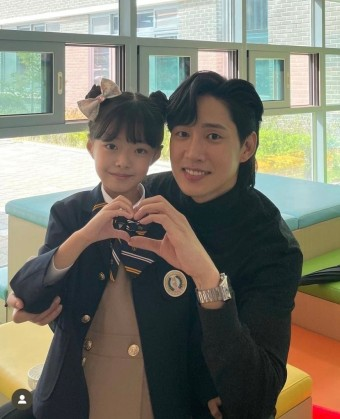

====================== group 25 =======================
face idx =  38
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/8_2.jpg


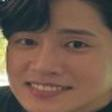

original_images_idx_list =  8


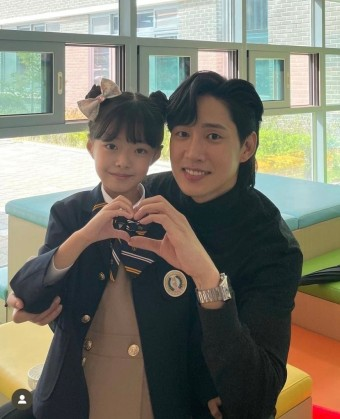

====================== group 26 =======================
face idx =  39
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/9_1.jpg


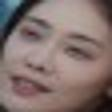

original_images_idx_list =  9


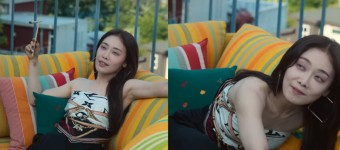

====================== group 27 =======================
face idx =  40
cosine =  -1
crop_path =  /content/drive/MyDrive/Capstone_FaceRecognition/crop/group0/9_2.jpg


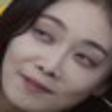

original_images_idx_list =  9


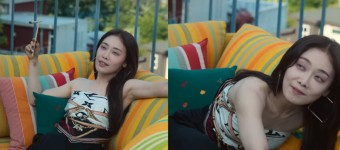

In [8]:
# grouping 잘됐나 테스트 2 (original url 연결잘됐나 original 이미지도 같이 출력해보기기)
from google.colab.patches import cv2_imshow

for i in range(len(groups)):
  print("======================================================")
  print("====================== group", i, "=======================")
  for j in range(len(groups[i]["face_list"])):
    print("face idx = ", groups[i]["face2_idx_list"][j]) #face idx
    print("cosine = ", groups[i]["cosine_similarity_list"][j]) #cosine distance
    #cv2_imshow(groups[i]["face_list"][j]) #face

    crop_path = groups[i]["crop_path_list"][j]
    original_images_idx = groups[i]["original_images_idx_list"][j]
    
    print("crop_path = ", crop_path)
    cv2_imshow(cv2.imread(crop_path)) 
  
    print("original_images_idx_list = ", original_images_idx)
    url = images[original_images_idx]["url"]
    resp = urllib.request.urlopen(url)
    image = np.asarray(bytearray(resp.read()), dtype='uint8')
    image = cv2.imdecode(image, cv2.IMREAD_COLOR)
    cv2_imshow(image)

In [9]:
# group len이 1인건 group index 0 으로 변경
for group_idx, group in enumerate(groups):
  if len(group["original_images_idx_list"]) == 1 :
    print("group idx = ", group_idx)
    images_idx = group["original_images_idx_list"][0]
    images[images_idx]["group_idx"].remove(group_idx)
    if -1 not in images[images_idx]["group_idx"] :
      images[images_idx]["group_idx"].append(-1)

group idx =  0
group idx =  1
group idx =  2
group idx =  3
group idx =  6
group idx =  7
group idx =  9
group idx =  11
group idx =  12
group idx =  14
group idx =  15
group idx =  16
group idx =  17
group idx =  18
group idx =  19
group idx =  20
group idx =  21
group idx =  22
group idx =  23
group idx =  24
group idx =  25
group idx =  26
group idx =  27


In [10]:
#  최종값 잘 들어갔나 확인 (images에 group_idx list가 최종값)
for _, image in enumerate(images):
  print("image idx = ", image["id"])
  for _, group_idx in enumerate(image["group_idx"]):
    print(group_idx)

image idx =  19
4
5
-1
image idx =  20
4
8
-1
image idx =  21
13
10
-1
image idx =  22
10
8
4
-1
image idx =  23
4
image idx =  24
4
image idx =  25
5
image idx =  26
-1
image idx =  27
-1
image idx =  28
-1
image idx =  29
8
4
-1
image idx =  30
8
-1
image idx =  31
10
-1
image idx =  32
13
image idx =  33
5
image idx =  34
-1
image idx =  35
-1
